# Пайплайн обучения модели [YOLO 12n ](https://docs.ultralytics.com/ru/models/yolo12/#overview) для задачи детекции логотипа Т-Банка


![Т-Банк](https://itgorky.ru/rest/file/4076/T-BANK_%20logo_yellow_left_rus.png)

## Подготовка данных

In [ ]:
!pip install -q clearml ultralytics

In [ ]:
from google.colab import userdata
import os

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Логируем эксперименты в ClearML, необходимо ввести ключи в секрет Google Colab

In [ ]:
os.environ["CLEARML_WEB_HOST"] = "https://app.clear.ml"
os.environ["CLEARML_API_HOST"] = "https://api.clear.ml"
os.environ["CLEARML_FILES_HOST"] = "https://files.clear.ml"

os.environ["CLEARML_API_ACCESS_KEY"] = userdata.get('CLEARML_API_ACCESS_KEY')
os.environ["CLEARML_API_SECRET_KEY"] = userdata.get('CLEARML_API_SECRET_KEY')

In [ ]:
from clearml import Task
task = Task.init(project_name="tlogo_detection", task_name="yolov12n_big_Dataset_extrax2_ATMs_augs")

ClearML Task: created new task id=0c3a44e3bf564c8082f316a1b71022ab
2025-09-15 08:29:24,620 - clearml.Task - INFO - Storing jupyter notebook directly as code
ClearML results page: https://app.clear.ml/projects/a2fcd9f4c6af455c8ed9db5c4af4886e/experiments/0c3a44e3bf564c8082f316a1b71022ab/output/log


In [ ]:
import os
import torch
from ultralytics import YOLO
import albumentations as A
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import random
import glob
import time

### Копируем датасет с Google Drive, для воспроизведения необходимо заменить на свой путь

In [ ]:
!cp '/content/drive/MyDrive/tbank_sirius/dataset_tlogo.zip' '/content/'

In [ ]:
!unzip /content/dataset_tlogo.zip

Archive:  /content/dataset_tlogo.zip
   creating: dataset_tlogo/
   creating: dataset_tlogo/tbank_logo.v1i.yolov12/
   creating: dataset_tlogo/tbank_logo.v1i.yolov12/.ipynb_checkpoints/
   creating: dataset_tlogo/tbank_logo.v1i.yolov12/train/
   creating: dataset_tlogo/tbank_logo.v1i.yolov12/train/images/
  inflating: dataset_tlogo/tbank_logo.v1i.yolov12/train/images/00a448e38fe94fa86dbee6af18044c2d_jpg.rf.0d728fecdb8d47bff4d5dd14ea596ede.jpg  
  inflating: dataset_tlogo/tbank_logo.v1i.yolov12/train/images/007ae5151b41a49b1fd742a34fabd946_jpg.rf.097c410dc64f3f8076b0207d65c6ceca.jpg  
  inflating: dataset_tlogo/tbank_logo.v1i.yolov12/train/images/6b06d3b3-b089-4d6d-8319-8f6e17becc52_png.rf.3b0bc4f588f8dbba46e19ec870d3ce01.jpg  
  inflating: dataset_tlogo/tbank_logo.v1i.yolov12/train/images/00e7c966cf9b9385091cb22db6c43453_jpg.rf.25f4153d6fe98885b19757eb5f47adef.jpg  
  inflating: dataset_tlogo/tbank_logo.v1i.yolov12/train/images/0147c99bada377c4ea9d0c4e3d1a23eb_jpg.rf.3f2989d8a21471dd53

### Загрузка модели

In [ ]:
data_path = '/content/dataset_tlogo/tbank_logo.v1i.yolov12/data.yaml'
model_name = "yolo12n.pt"

print(f"Data path: {data_path}")
print(f"Model: {model_name}")
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name()}")

Data path: /content/dataset_tlogo/tbank_logo.v1i.yolov12/data.yaml
Model: yolo12n.pt
CUDA available: True
GPU: Tesla T4


In [ ]:
model = YOLO(model_name)

2025-09-15 08:29:34,453 - clearml.model - INFO - Selected model id: 505b8e45a4d341dd959c64c9be9fdf9a


### Обучение модели

WARNING ⚠️ 'crop_fraction' is deprecated and will be removed in the future.
Ultralytics 8.3.199 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=None, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.3, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_tlogo/tbank_logo.v1i.yolov12/data.yaml, degrees=20.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.5, dynamic=False, embed=None, epochs=100, erasing=0.2, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.15, mode=train, model=yolo12n.pt, momentum=0.937, mosaic=0.75, multi_scale=False, name=tbank_logo_v12, nbs=64, nms=False, ops

                                            0% | 0.00/5.24 MB [00:00<?, ?MB/s]: 

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f0979fbc320>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

█████████████████████████████████ 100% | 5.24/5.24 MB [00:00<00:00, 41.14MB/s]: 

2025-09-15 09:05:07,709 - clearml.Task - INFO - Completed model upload to https://files.clear.ml/tlogo_detection/yolov12n_big_Dataset_extrax2_ATMs_augs.0c3a44e3bf564c8082f316a1b71022ab/models/best.pt


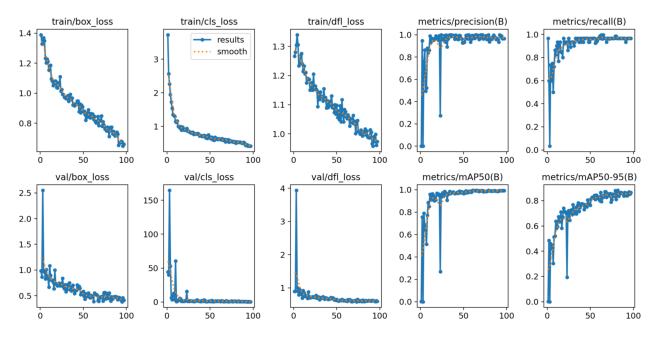

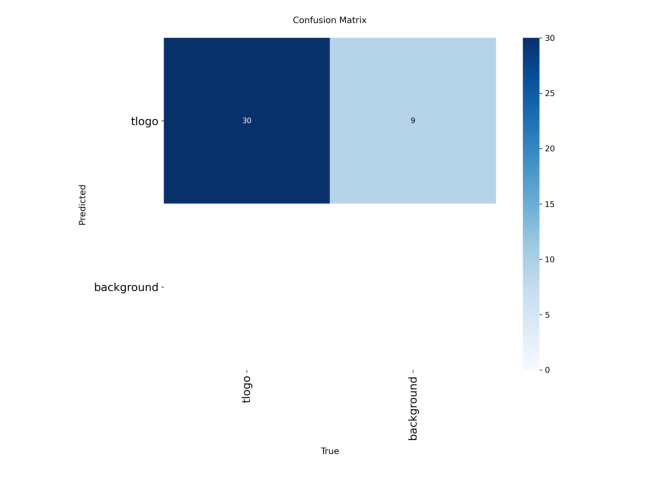

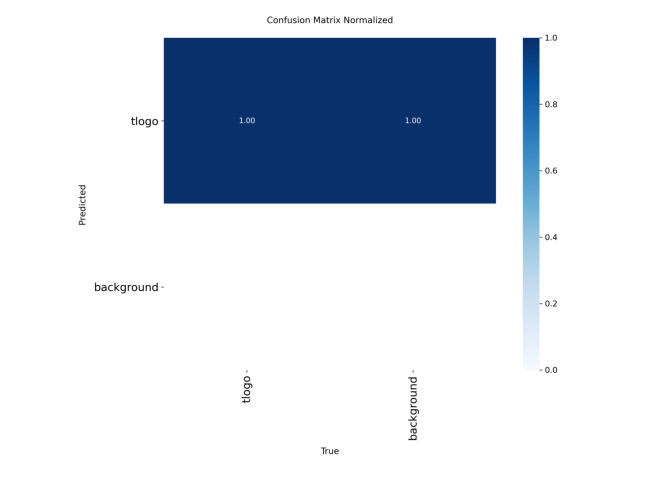

In [ ]:
model.train(
    data=data_path,
    epochs=100,
    batch=16,
    imgsz=640,
    patience=15,
    save=True,
    project='runs/detect',
    name='tbank_logo_v12',

    # Augmentations
    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4,
    degrees=20.0,
    translate=0.1,
    scale=0.5,
    shear=2.0,
    perspective=0.0003,
    fliplr=0.5,
    bgr=0.0,
    mosaic=0.75,
    mixup=0.15,
    copy_paste=0.3,

    erasing=0.2,
    crop_fraction=1.0,

    auto_augment=None,

    val=True,
    split='val',
    save_period=10,

    workers=8,
    dropout=0.5,

    verbose=True,
    plots=True,

    cache=False,
    seed=42,
    deterministic=True,
)


### Метрики на валидации

In [ ]:
results = model.val()

print(f"mAP50: {results.box.map50:.4f}")
print(f"mAP50-95: {results.box.map:.4f}")
print(f"Precision: {results.box.mp:.4f}")
print(f"Recall: {results.box.mr:.4f}")

best_model_path = 'runs/detect/tbank_logo_v12/weights/best.pt'
print(f"Best model saved at: {best_model_path}")


Ultralytics 8.3.199 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,556,923 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 898.2±634.7 MB/s, size: 23.0 KB)
val: Scanning /content/dataset_tlogo/tbank_logo.v1i.yolov12/valid/labels.cache... 354 images, 326 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 354/354 624.9Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 23/23 3.1it/s 7.3s
                   all        354         30      0.966      0.967       0.99      0.881
Speed: 0.6ms preprocess, 13.7ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to /content/runs/detect/tbank_logo_v122
mAP50: 0.9900
mAP50-95: 0.8810
Precision: 0.9662
Recall: 0.9667
Best model saved at: runs/detect/tbank_logo_v12/weights/best.pt


### Визуальная оценка качества детекции на валидационном датасете

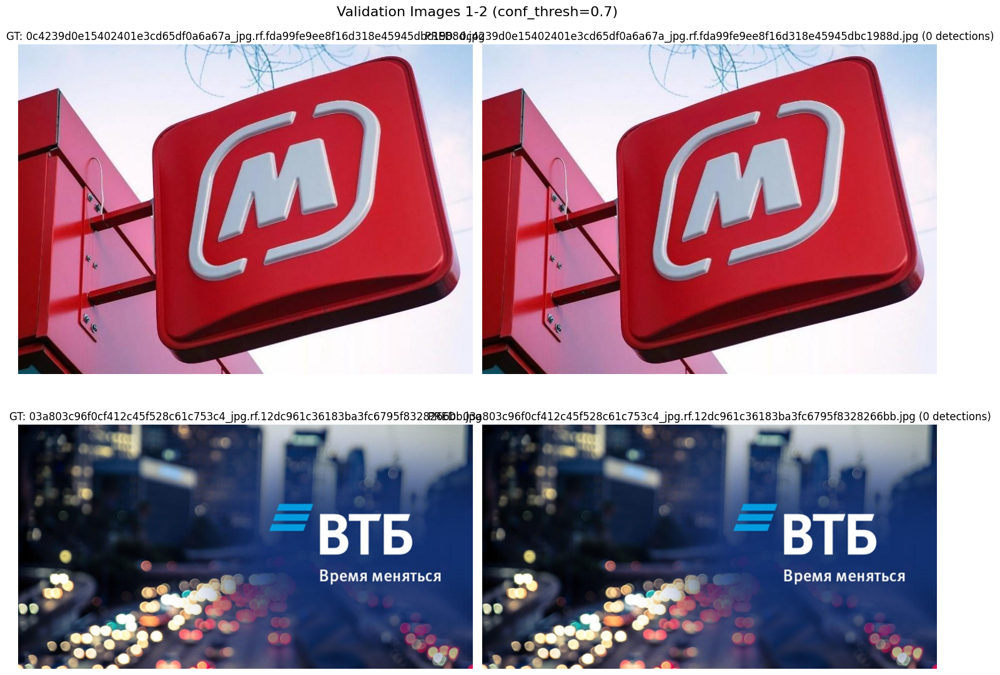

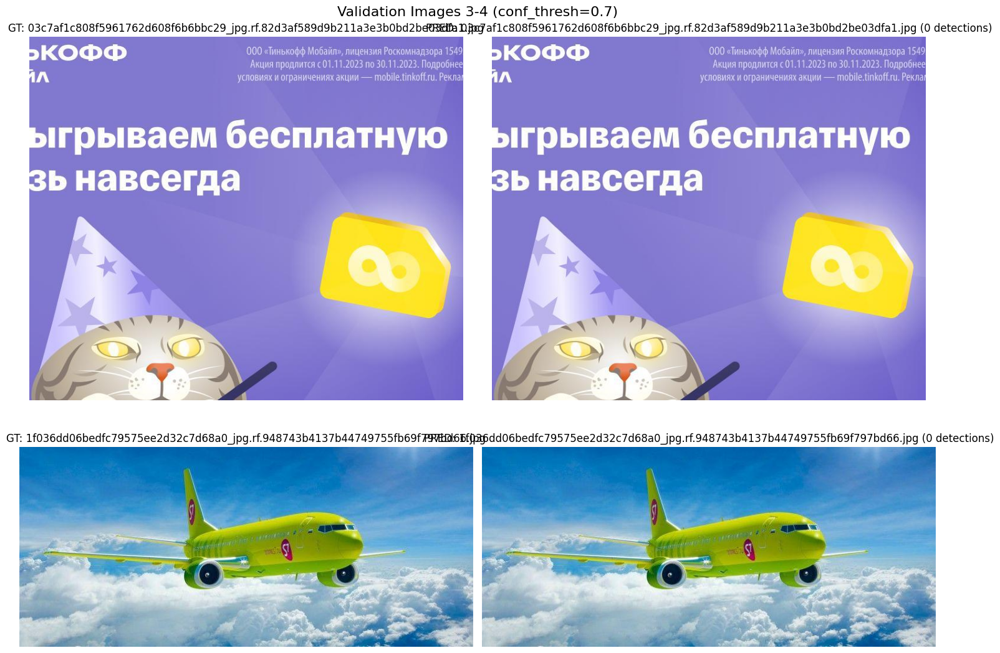

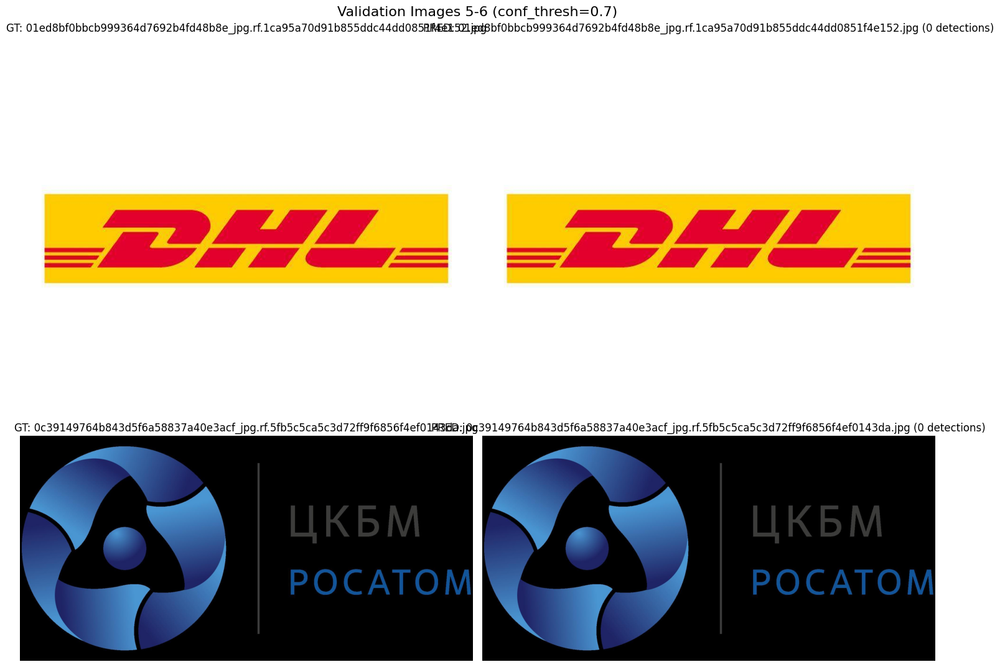

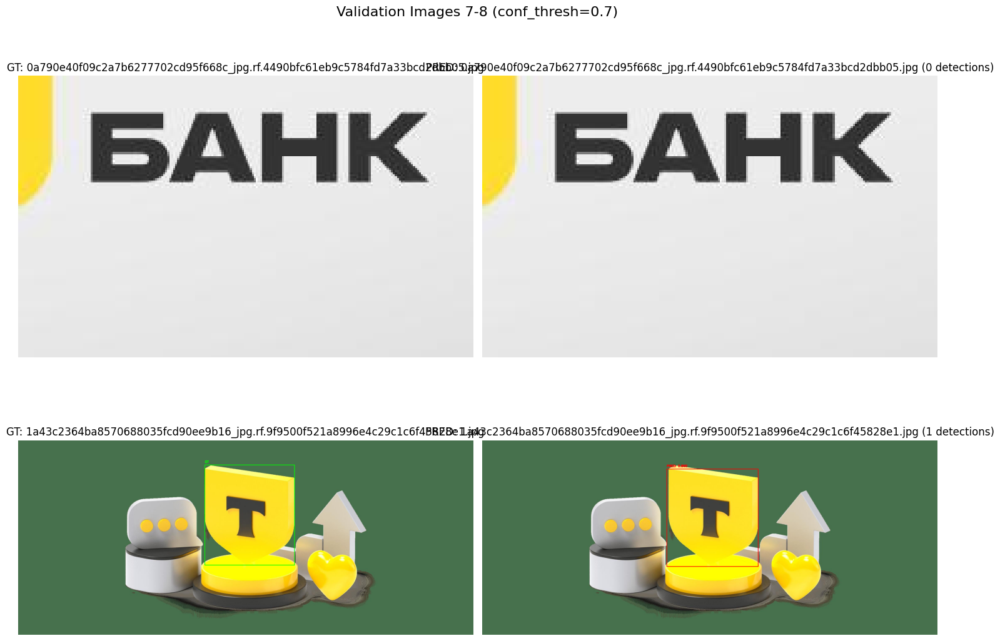

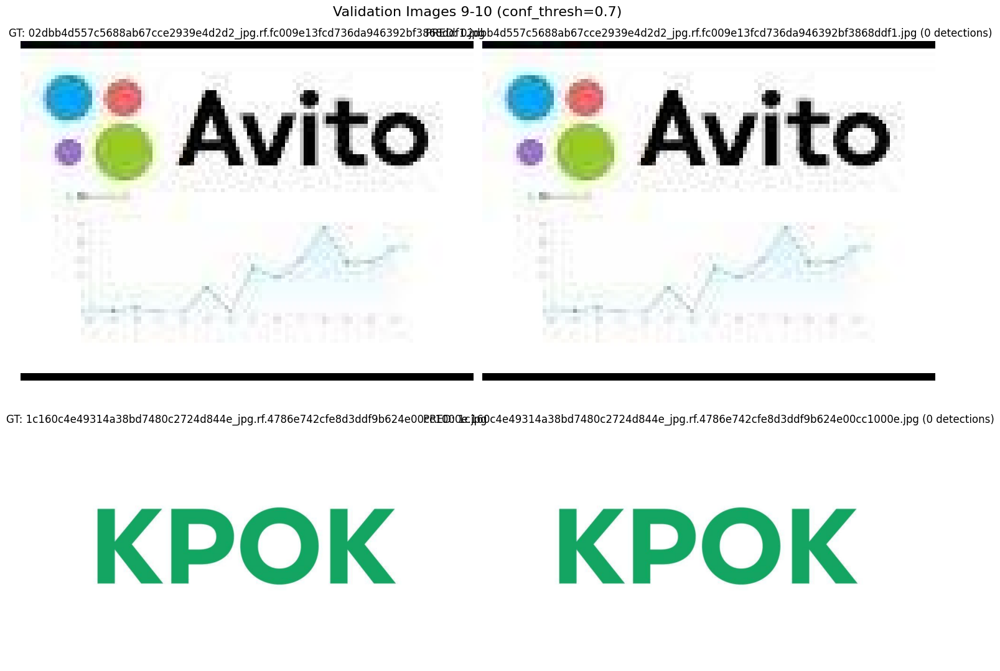

...

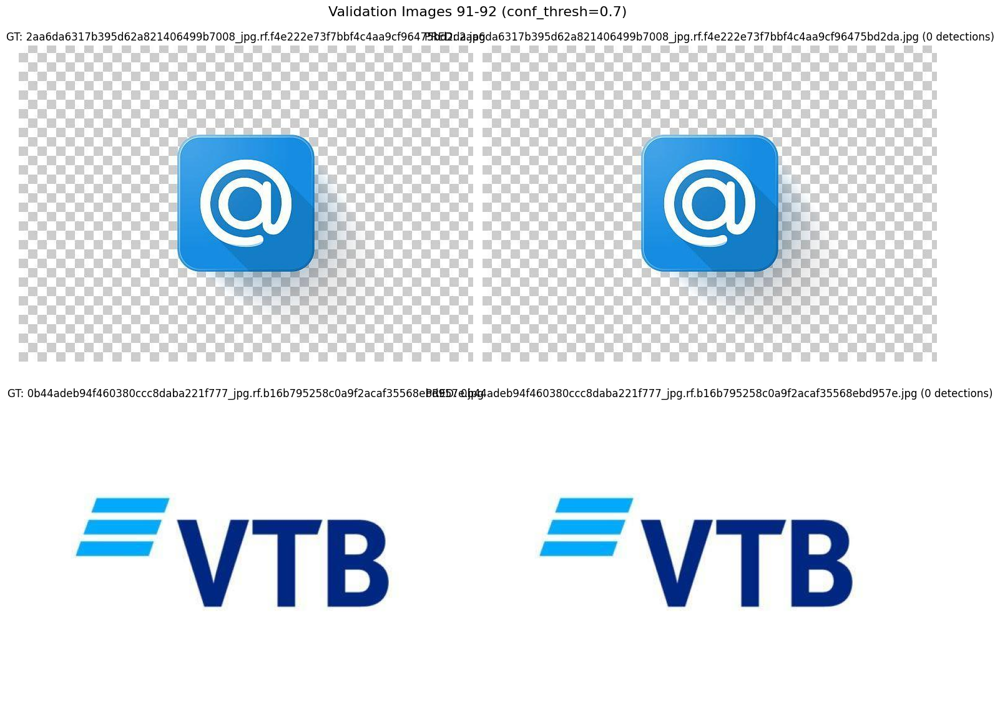

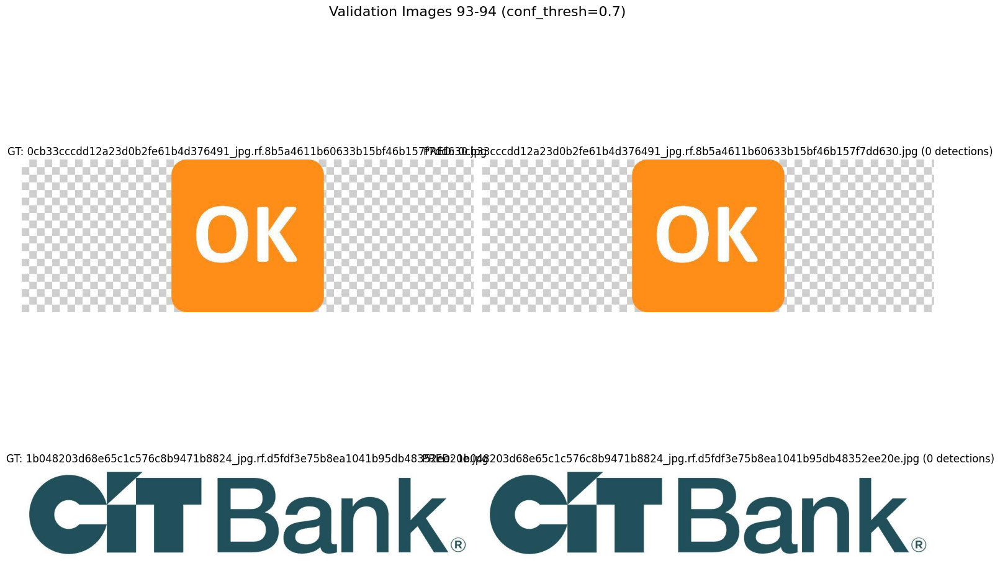

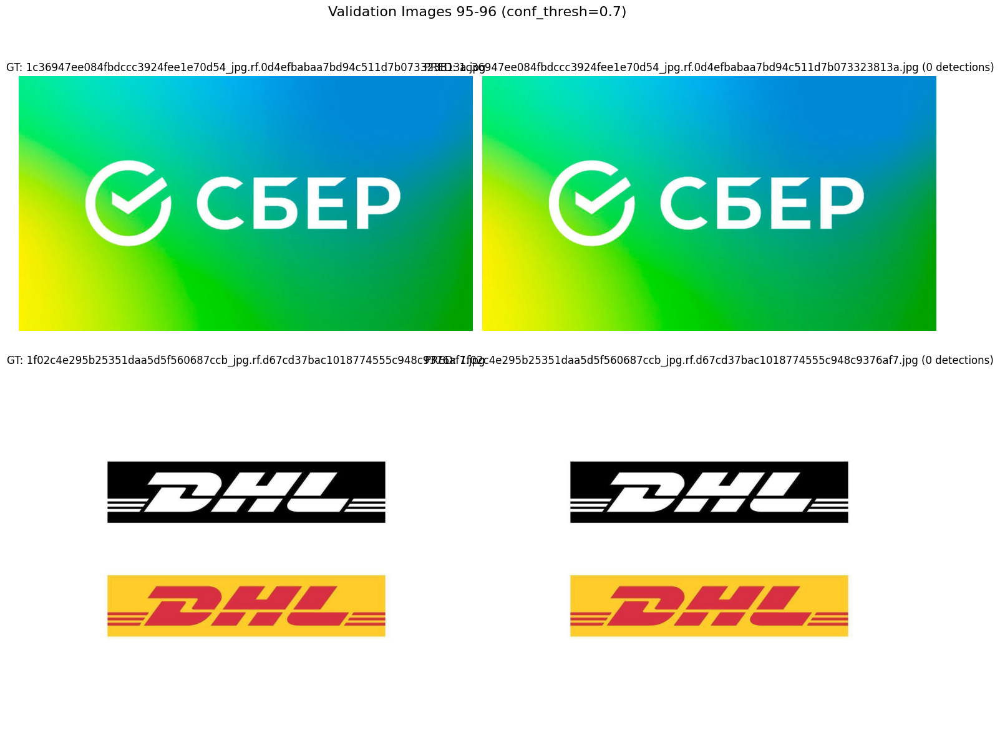

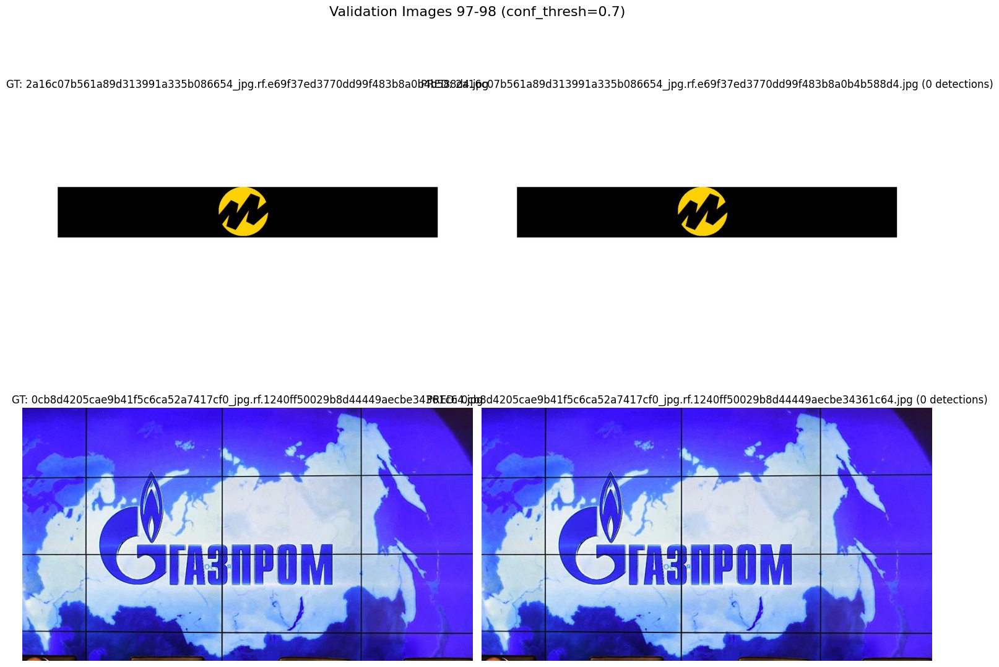

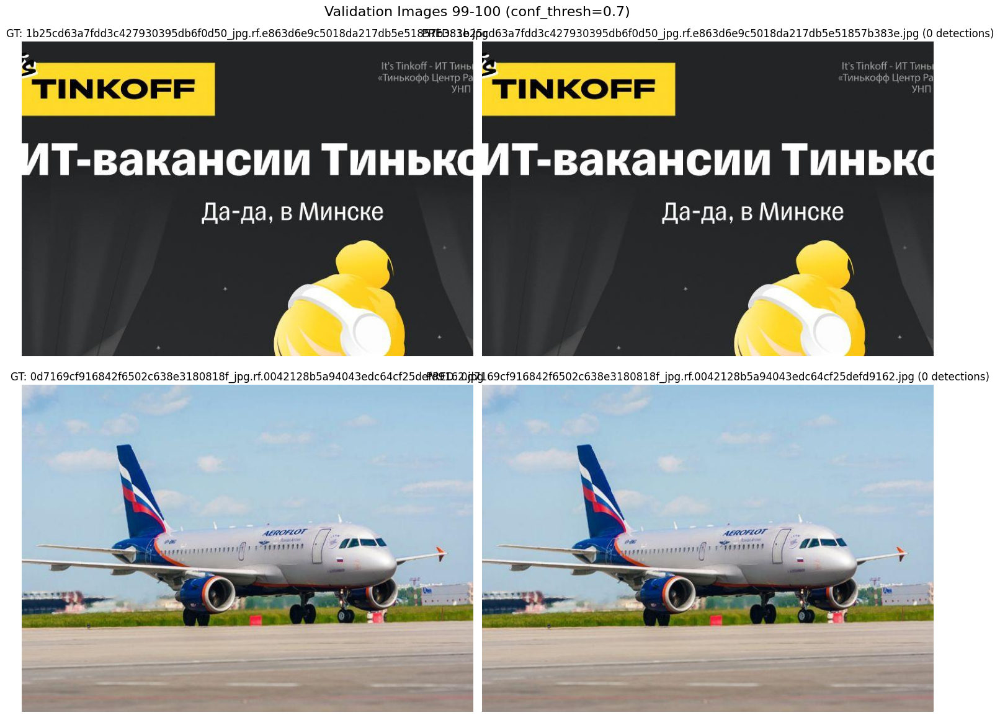

In [ ]:
best_model = YOLO('runs/detect/tbank_logo_v12/weights/best.pt')

valid_images_path = '/content/dataset_tlogo/tbank_logo.v1i.yolov12/valid/images'
valid_labels_path = '/content/dataset_tlogo/tbank_logo.v1i.yolov12/valid/labels'

valid_images = glob.glob(f"{valid_images_path}/*.jpg")[0:345]

confidence_threshold = 0.6

def parse_yolo_label(label_path, img_width, img_height):
    boxes = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) >= 5:
                    class_id, x_center, y_center, width, height = map(float, parts[:5])
                    x_center *= img_width
                    y_center *= img_height
                    width *= img_width
                    height *= img_height

                    x1 = int(x_center - width/2)
                    y1 = int(y_center - height/2)
                    x2 = int(x_center + width/2)
                    y2 = int(y_center + height/2)

                    boxes.append((x1, y1, x2, y2, int(class_id)))
    return boxes

def draw_boxes(img, boxes, color, label_prefix, confidences=None):
    img_copy = img.copy()
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = box[:4]
        cv2.rectangle(img_copy, (x1, y1), (x2, y2), color, 2)

        if confidences is not None and i < len(confidences):
            label = f"{label_prefix}: {confidences[i]:.3f}"
        else:
            label = f"{label_prefix}"

        cv2.putText(img_copy, label, (x1, y1-10),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return img_copy

for i in range(0, min(100, len(valid_images)), 2):
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    fig.suptitle(f'Validation Images {i+1}-{min(i+2, len(valid_images))} (conf_thresh={confidence_threshold})', fontsize=16)

    for j in range(min(2, len(valid_images) - i)):
        img_path = valid_images[i + j]
        img_name = os.path.basename(img_path)

        label_name = img_name.replace('.jpg', '.txt')
        label_path = os.path.join(valid_labels_path, label_name)

        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_height, img_width = img.shape[:2]

        gt_boxes = parse_yolo_label(label_path, img_width, img_height)

        results = best_model.predict(img_path, conf=confidence_threshold, verbose=False)
        pred_boxes = []
        pred_confidences = []

        if len(results) > 0 and results[0].boxes is not None:
            for box in results[0].boxes:
                x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                confidence = box.conf[0].cpu().numpy()
                pred_boxes.append((int(x1), int(y1), int(x2), int(y2)))
                pred_confidences.append(float(confidence))

        img_gt = draw_boxes(img_rgb, gt_boxes, (0, 255, 0), 'GT')

        img_pred = draw_boxes(img_rgb, pred_boxes, (255, 0, 0), 'PRED', pred_confidences)

        axes[j, 0].imshow(img_gt)
        axes[j, 0].set_title(f'GT: {img_name}')
        axes[j, 0].axis('off')

        axes[j, 1].imshow(img_pred)
        axes[j, 1].set_title(f'PRED: {img_name} ({len(pred_boxes)} detections)')
        axes[j, 1].axis('off')

    if len(valid_images) - i == 1:
        axes[1, 0].axis('off')
        axes[1, 1].axis('off')

    plt.tight_layout()
    plt.show()


### Копирование с Google Drive более сложных примеров для валдиации ( необходимо заменить на свой путь )

In [ ]:
!cp -r '/content/drive/MyDrive/tbank_sirius/difficult_images' '/content/'

### Валидация на этих примерах

Image: 6336e9639c21.jpg
  Detection 1: bbox=(287, 108, 597, 494), conf=0.856, class=0
  Detection 2: bbox=(526, 96, 608, 198), conf=0.806, class=0


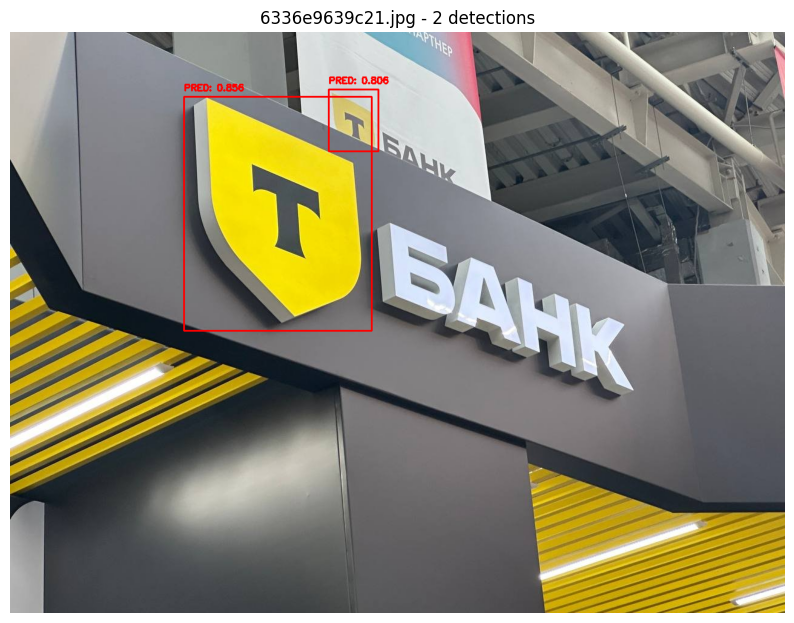


Image: 34cc146e1b31121c86b4a889db429d28.jpg
  Detection 1: bbox=(953, 134, 1039, 224), conf=0.836, class=0
  Detection 2: bbox=(1091, 587, 1131, 633), conf=0.816, class=0
  Detection 3: bbox=(997, 567, 1036, 638), conf=0.722, class=0
  Detection 4: bbox=(57, 205, 91, 276), conf=0.655, class=0


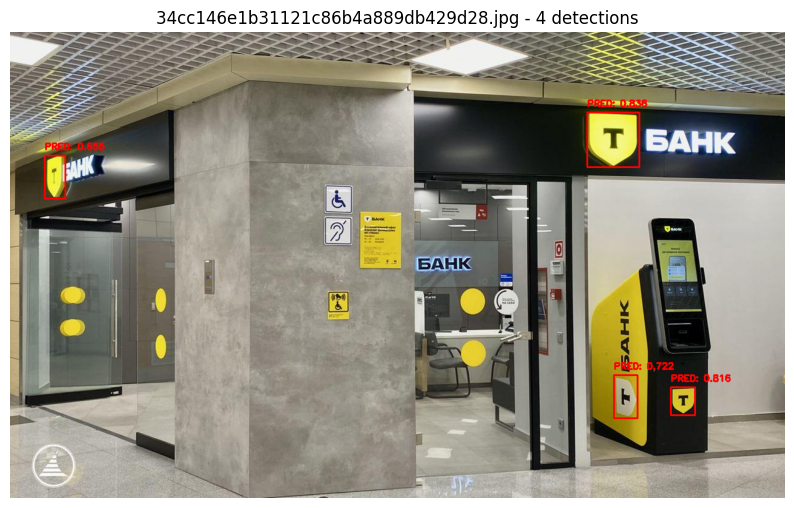


Image: ty7mkkrsrkpy0zqblqrqjy9y3bnl6pzo.jpg
  Detection 1: bbox=(145, 107, 181, 146), conf=0.855, class=0


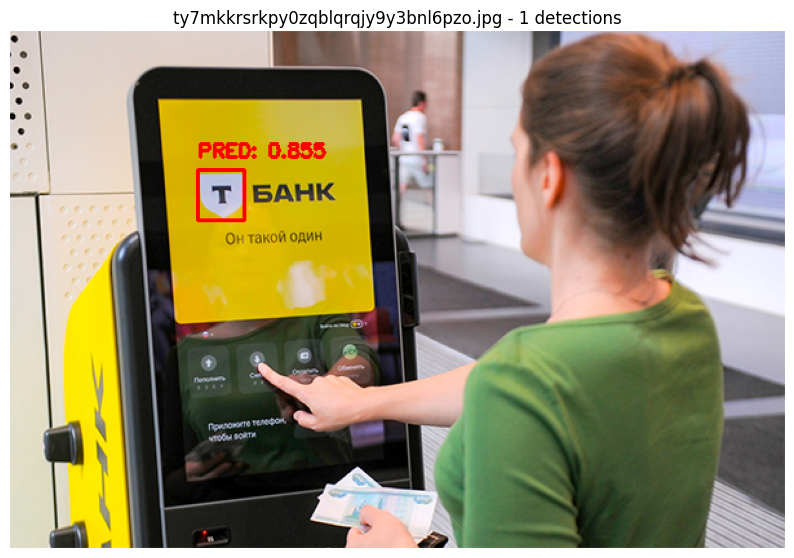


Image: 73004d24b45a-e1731514587116.jpg
  Detection 1: bbox=(585, 142, 693, 251), conf=0.883, class=0
  Detection 2: bbox=(969, 0, 1011, 24), conf=0.735, class=0


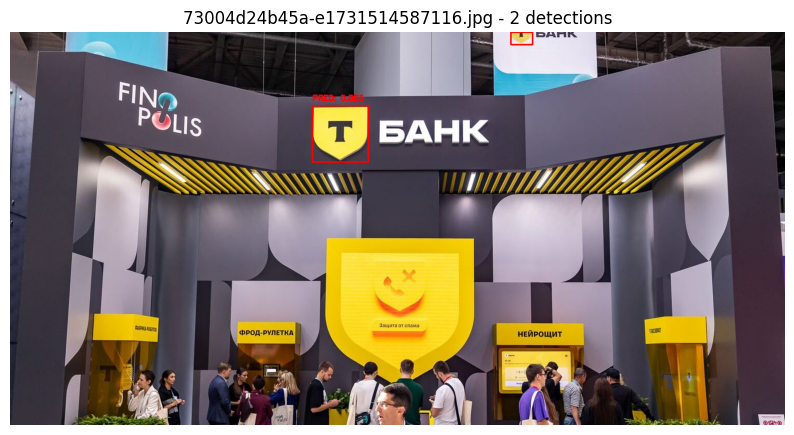


Image: 015c1ba6-3d9c-4826-8a96-6a05605c9df3.png
  Detection 1: bbox=(50, 534, 110, 594), conf=0.847, class=0
  Detection 2: bbox=(1162, 398, 1198, 433), conf=0.786, class=0


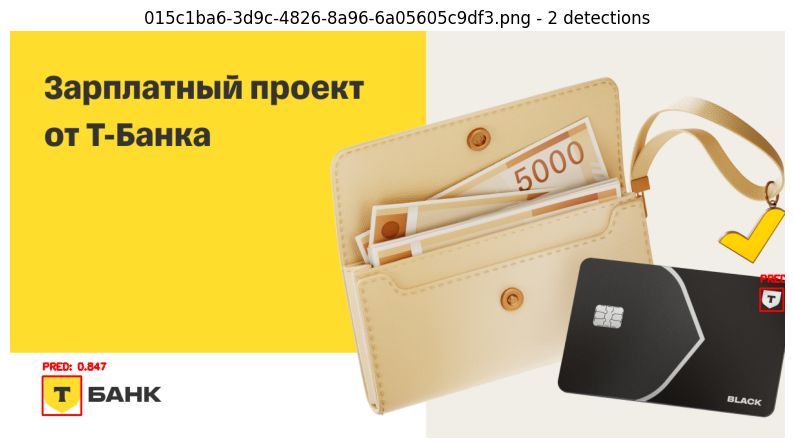


Image: 06122024-t-bank-will-make-it-easier-log-in-city-parking-app-using-t-id-2.png
  Detection 1: bbox=(59, 994, 128, 1066), conf=0.820, class=0
  Detection 2: bbox=(253, 674, 291, 709), conf=0.793, class=0


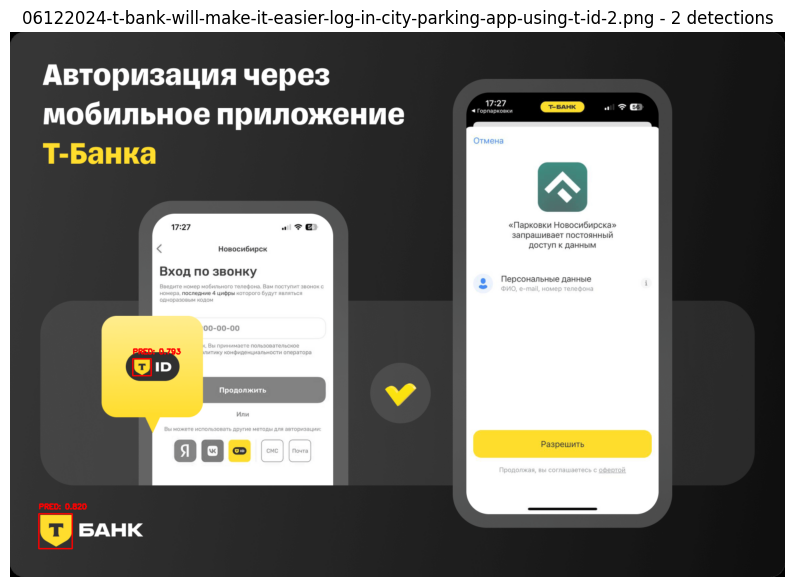


Image: t-bank-soda.png
  Detection 1: bbox=(605, 39, 666, 100), conf=0.875, class=0


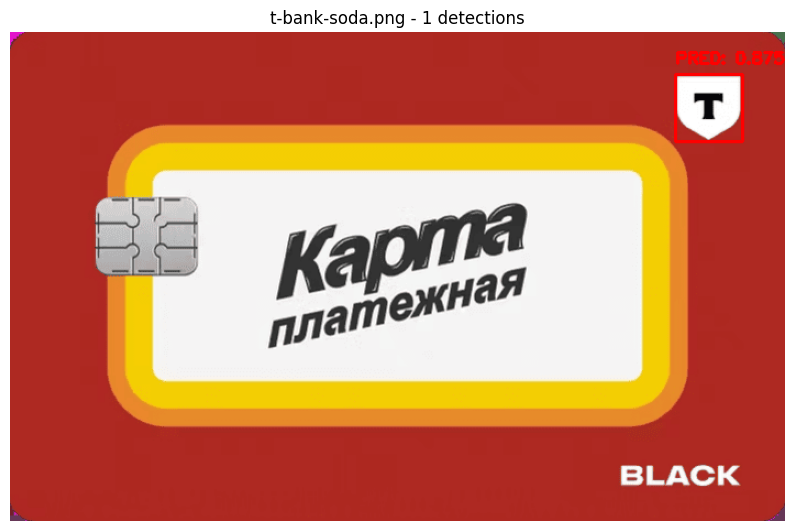


Image: common (3).jpeg
  Detection 1: bbox=(456, 1379, 640, 1575), conf=0.888, class=0
  Detection 2: bbox=(559, 3, 819, 298), conf=0.875, class=0
  Detection 3: bbox=(773, 1175, 863, 1499), conf=0.737, class=0


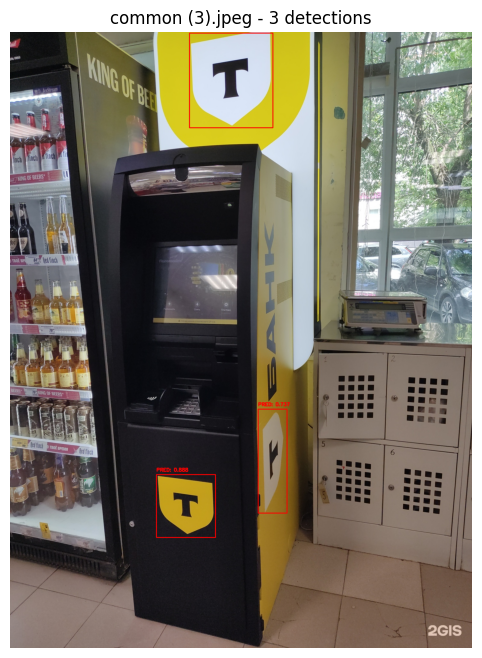


Image: 745c1a72891458c20948ec4e95fc4acf_ria_8787555hr.jpeg
  Detection 1: bbox=(389, 425, 511, 553), conf=0.846, class=0


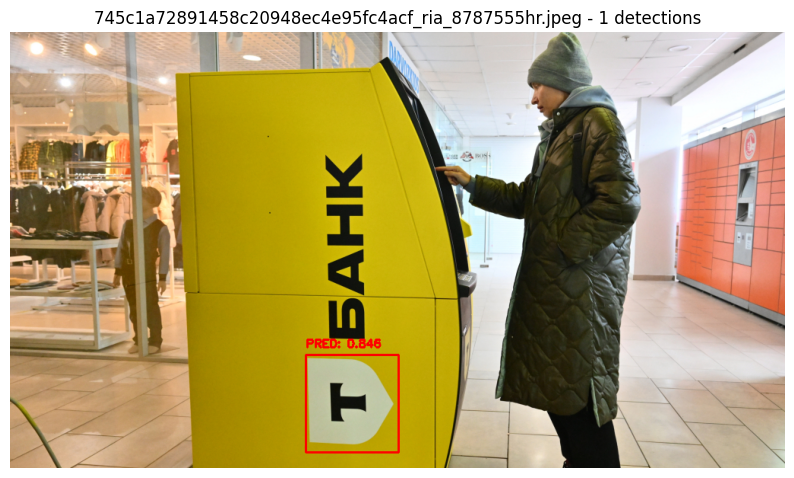


Image: common (6).jpeg
  Detection 1: bbox=(433, 1698, 660, 1918), conf=0.874, class=0
  Detection 2: bbox=(393, 88, 426, 124), conf=0.632, class=0


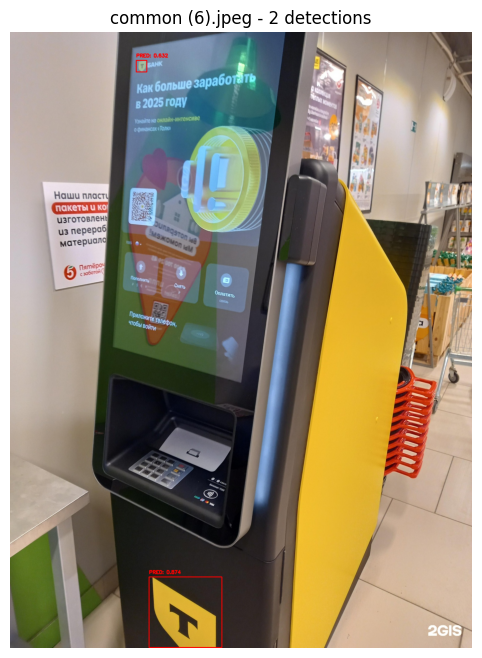


Image: common (9).jpeg
  Detection 1: bbox=(459, 1105, 593, 1289), conf=0.873, class=0
  Detection 2: bbox=(735, 1201, 868, 1413), conf=0.851, class=0


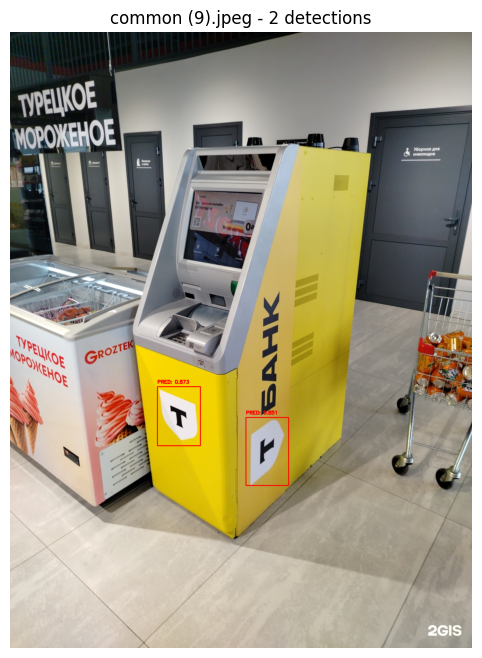


Image: scale_1200.jpeg
  Detection 1: bbox=(267, 129, 305, 171), conf=0.818, class=0
  Detection 2: bbox=(534, 470, 578, 518), conf=0.779, class=0
  Detection 3: bbox=(106, 338, 145, 385), conf=0.767, class=0


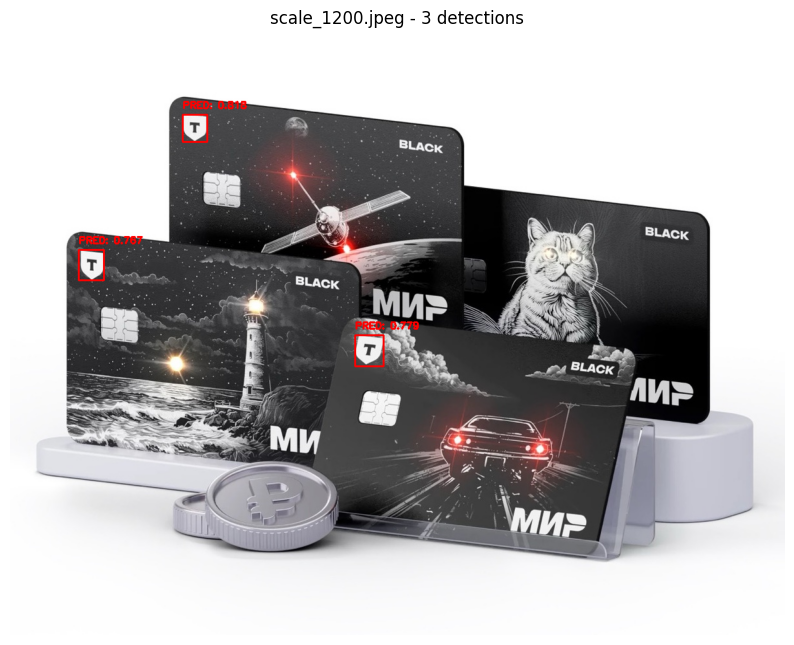


Image: images (5).jpeg
  Detection 1: bbox=(121, 225, 146, 255), conf=0.899, class=0
  Detection 2: bbox=(54, 9, 94, 60), conf=0.870, class=0
  Detection 3: bbox=(105, 40, 113, 50), conf=0.762, class=0
  Detection 4: bbox=(67, 207, 90, 248), conf=0.724, class=0


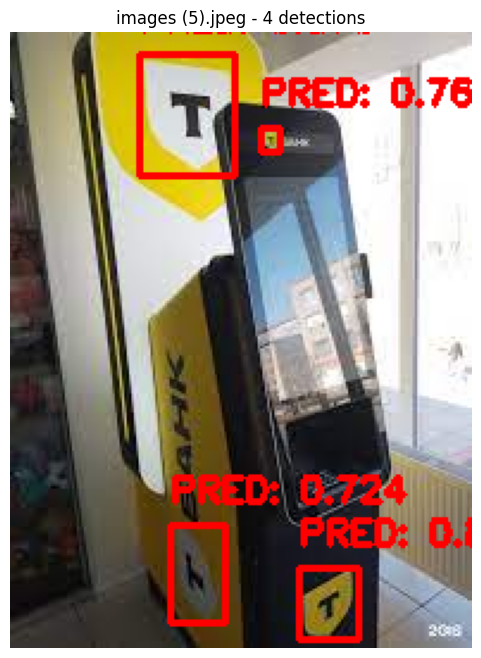


Image: orig.jpeg
  Detection 1: bbox=(668, 1025, 984, 1342), conf=0.883, class=0


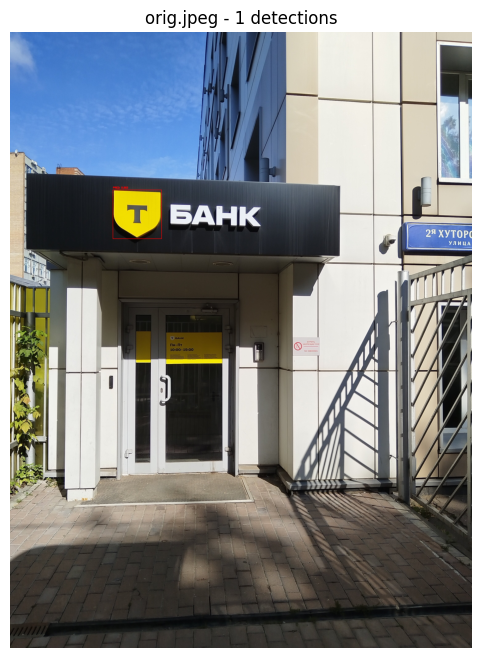


Image: common (2).jpeg
  Detection 1: bbox=(605, 1297, 741, 1467), conf=0.879, class=0
  Detection 2: bbox=(920, 1221, 1034, 1478), conf=0.850, class=0
  Detection 3: bbox=(651, 227, 692, 277), conf=0.832, class=0


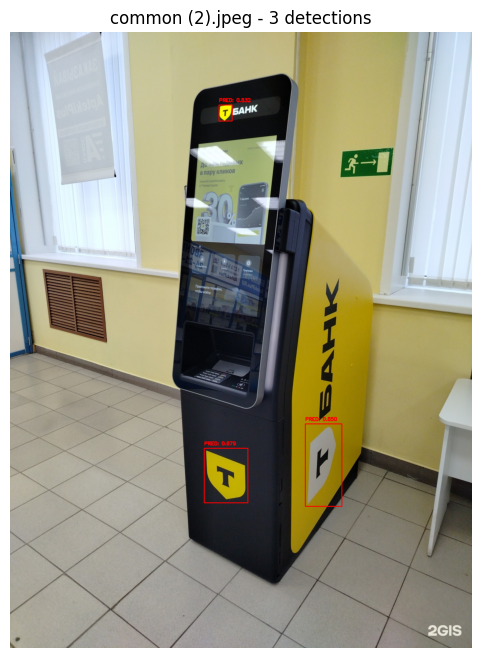


Image: images (4).jpeg
  Detection 1: bbox=(40, 11, 58, 30), conf=0.832, class=0


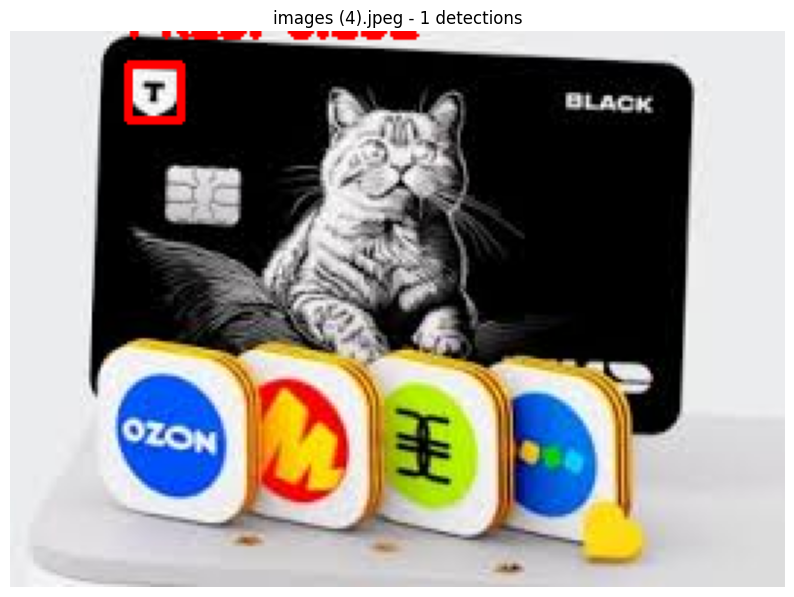


Image: common (8).jpeg
  Detection 1: bbox=(600, 1167, 719, 1295), conf=0.831, class=0
  Detection 2: bbox=(297, 1011, 397, 1133), conf=0.797, class=0
  Detection 3: bbox=(866, 1167, 949, 1351), conf=0.737, class=0
  Detection 4: bbox=(495, 1051, 564, 1207), conf=0.647, class=0


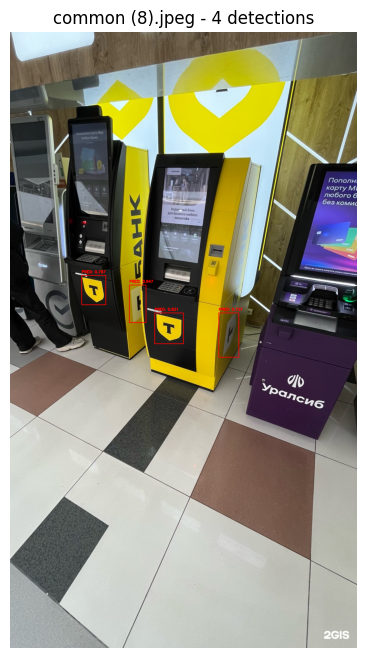


Image: common (4).jpeg
  Detection 1: bbox=(825, 1073, 950, 1328), conf=0.888, class=0
  Detection 2: bbox=(409, 1166, 549, 1354), conf=0.887, class=0


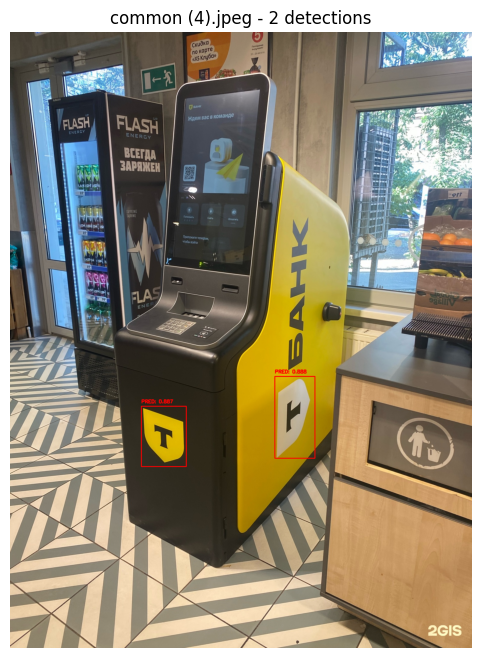


Image: common (5).jpeg
  Detection 1: bbox=(825, 1073, 950, 1328), conf=0.888, class=0
  Detection 2: bbox=(409, 1166, 549, 1354), conf=0.887, class=0


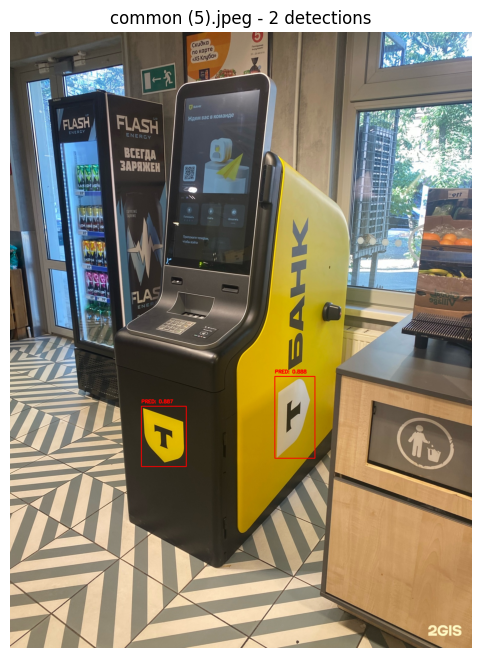


Image: common (7).jpeg
  Detection 1: bbox=(902, 1668, 1083, 1903), conf=0.901, class=0
  Detection 2: bbox=(406, 80, 703, 437), conf=0.881, class=0
  Detection 3: bbox=(786, 306, 844, 373), conf=0.830, class=0
  Detection 4: bbox=(498, 1522, 669, 1855), conf=0.733, class=0


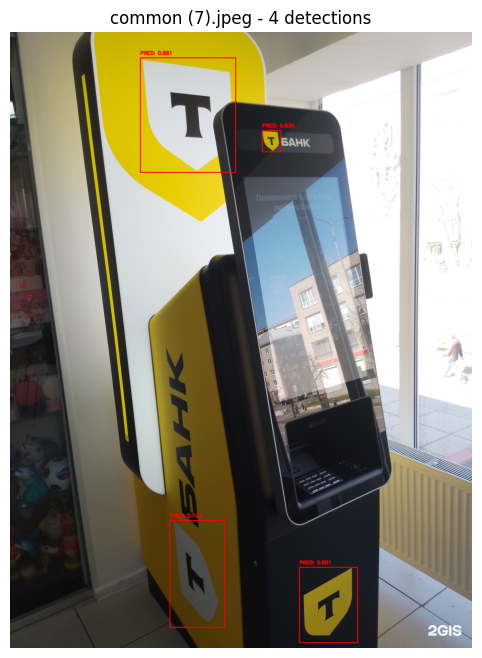


Image: common.jpeg
  Detection 1: bbox=(690, 1482, 886, 1681), conf=0.892, class=0


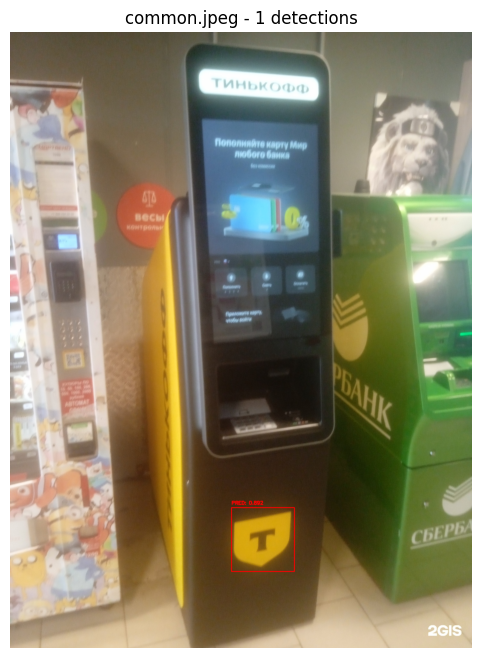


Image: images (6).jpeg


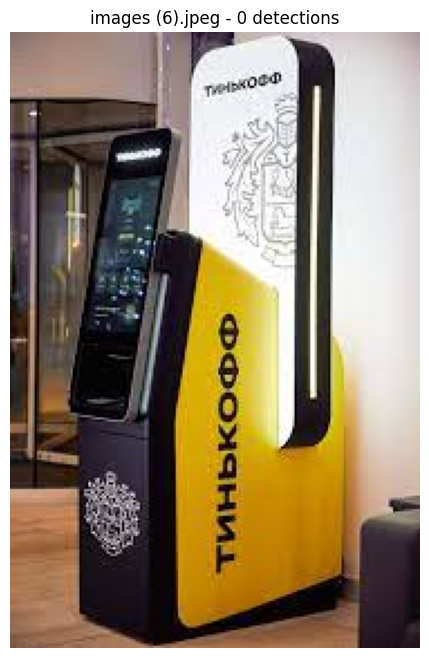


Image: scale_1200 (1).jpeg
  Detection 1: bbox=(118, 243, 188, 326), conf=0.830, class=0


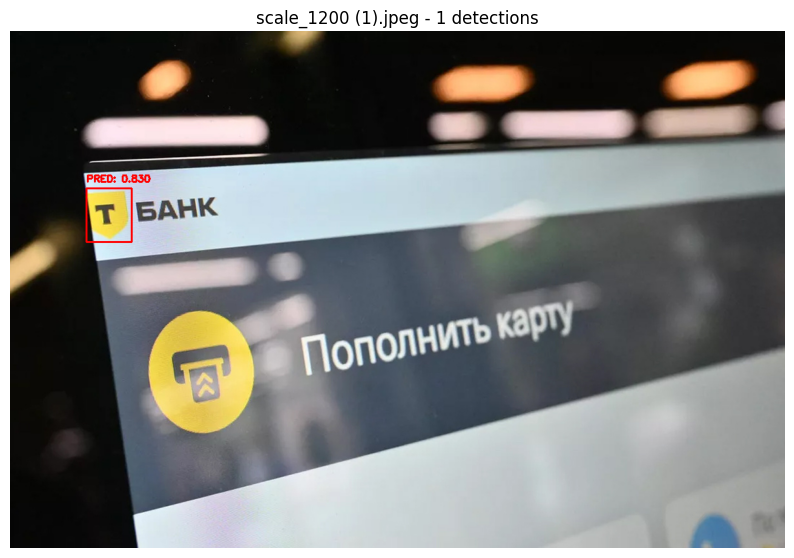


Image: 347303609152910.jpeg
  Detection 1: bbox=(472, 18, 584, 139), conf=0.904, class=0


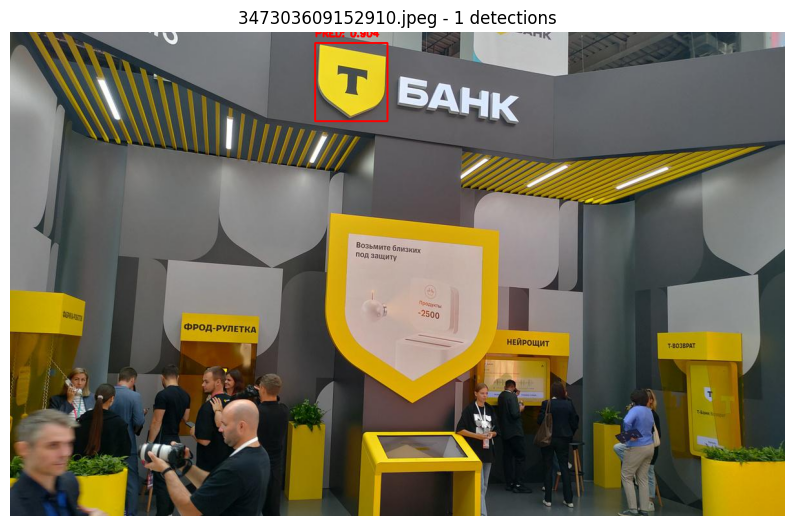


Image: 1756892949531.jpeg
  Detection 1: bbox=(209, 31, 242, 70), conf=0.858, class=0


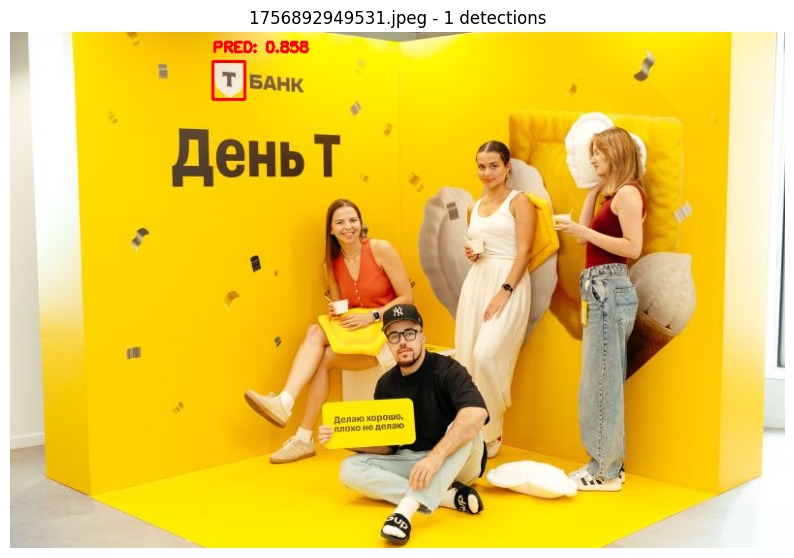


Image: common (1).jpeg
  Detection 1: bbox=(481, 1035, 581, 1148), conf=0.886, class=0
  Detection 2: bbox=(334, 215, 487, 387), conf=0.874, class=0
  Detection 3: bbox=(471, 345, 501, 376), conf=0.785, class=0
  Detection 4: bbox=(316, 962, 369, 1130), conf=0.772, class=0


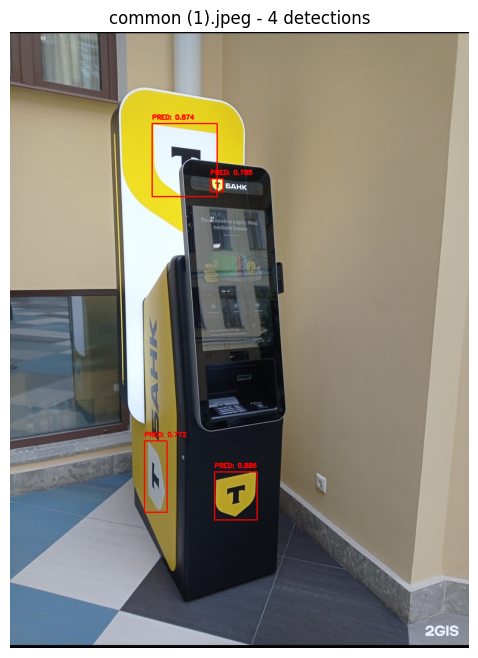

In [ ]:
val_images_path = '/content/difficult_images'
val_images = []
for ext in ['*.jpg', '*.png', '*.jpeg']:
    val_images.extend(glob.glob(f"{val_images_path}/{ext}"))

for img_path in val_images:
    img_name = os.path.basename(img_path)
    print(f"Image: {img_name}")

    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    results = best_model.predict(img_path, conf=0.6, verbose=False)

    pred_boxes = []
    pred_confidences = []

    if len(results) > 0 and results[0].boxes is not None:
        for i, box in enumerate(results[0].boxes):
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
            confidence = box.conf[0].cpu().numpy()
            class_id = int(box.cls[0].cpu().numpy())
            pred_boxes.append((int(x1), int(y1), int(x2), int(y2)))
            pred_confidences.append(float(confidence))
            print(f"  Detection {i+1}: bbox=({int(x1)}, {int(y1)}, {int(x2)}, {int(y2)}), conf={confidence:.3f}, class={class_id}")
    else:
        print("  No detections")

    img_with_boxes = draw_boxes(img_rgb, pred_boxes, (255, 0, 0), 'PRED', pred_confidences)

    plt.figure(figsize=(10, 8))
    plt.imshow(img_with_boxes)
    plt.title(f'{img_name} - {len(pred_boxes)} detections')
    plt.axis('off')
    plt.show()
    print()

### Посмотрим на баланс классов (negative samples и >1 tlogo) в трейне

In [ ]:
directory = '/content/dataset_tlogo/tbank_logo.v1i.yolov12/train/labels'
count_zero = 0
count_not_zero = 0
for name in os.listdir(directory):
    if name.lower().endswith('.txt'):
        path = os.path.join(directory, name)
        if os.path.isfile(path) and os.path.getsize(path) > 0:
            count_not_zero += 1
        elif os.path.isfile(path) and os.path.getsize(path) == 0:
            count_zero += 1
print(f'Количество непустых .txt файлов в трейне: {count_not_zero}')
print(f'Количество пустых .txt файлов в трейне: {count_zero}')

Количество непустых .txt файлов в трейне: 321
Количество пустых .txt файлов в трейне: 329


### Закрываем таску в ClearML

In [ ]:
task.close()